In [1]:
import os
import time

import cv2
import numpy as np
from skimage import segmentation
import matplotlib.pyplot as plt

import torch
import torch.nn as nn

import tarfile
import os
import numpy as np
import skimage
from sklearn.mixture import GaussianMixture
import warnings
import scipy.ndimage as ndimage
from skimage import measure
import cv2 as cv
from sklearn.mixture import GaussianMixture
import scipy.stats 
from skimage.segmentation import active_contour
from skimage.filters import gaussian
warnings.filterwarnings('ignore')
import matplotlib.patches as patchess
from collections import  Counter

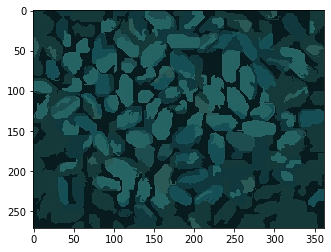

In [2]:
image = cv2.imread('seg_bean_18s.jpg')
plt.imshow( image,cmap='gray')

In [16]:
gray_image=skimage.color.rgb2gray(image)*256
temp_threshold=skimage.filters.threshold_minimum(gray_image)
temp_threshold

32.1783137254902

In [17]:
img_gray = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)

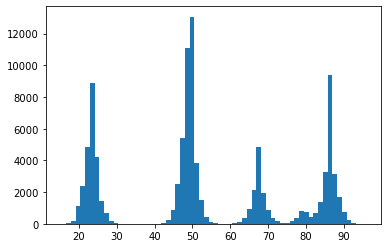

In [31]:
plt.hist(gray_image.ravel(),bins=64)
plt.show()

In [42]:
temp_img=gray_image.copy()
temp_img=-temp_img
threshold_1=-skimage.filters.threshold_minimum(temp_img)


temp_img=gray_image.copy()
temp_img=temp_img[temp_img<threshold_1]
temp_img=-temp_img
threshold_2=-skimage.filters.threshold_minimum(temp_img)
threshold_2

65.12942843137253

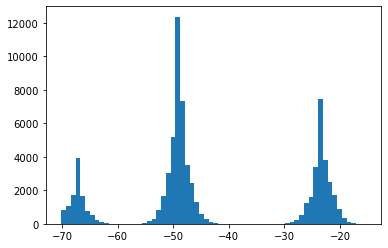

In [43]:
plt.hist(temp_img.ravel(),bins=64)
plt.show()

In [55]:
# define a funcion that return 8 neighbors of a start point that satisfied the set threshold
def find_neighbor(image, start_x, start_y,  threshold_1=threshold_1,threshold_2=threshold_2):
    img_len = image.shape[0]
    img_width = image.shape[1]
    #new_image=np.zeros((img_len,img_width))
    new_x=np.arange(start_x-1,start_x + 2)
    new_y=np.arange(start_y-1,start_y + 2)
    candidate=[]
    for temp_x in new_x:
        for temp_y in new_y:
            # discard neighbor points that are beyond the size of image
            if temp_x<0 or temp_x>=img_len:
                continue
            if temp_y<0 or temp_y>=img_width:
                continue
            # only get new neighbor points that don't exist in our candidate list
            if [temp_x, temp_y] in candidate:
                continue
            # no need to consider the center point itself
            if temp_x==start_x and temp_y==start_y:
                continue
            #print(image[start_x][start_y],image[temp_x][temp_y],np.abs(image[temp_x][temp_y]-image[start_x][start_y]))
            '''
            if  image[start_x][start_y]>threshold_1:
                if image[temp_x][temp_y] > threshold_1:
                    candidate.append([temp_x,temp_y])
            else:
                if image[temp_x][temp_y] > threshold_2 and image[temp_x][temp_y] < threshold_1 :
                    candidate.append([temp_x,temp_y])
            '''
            if image[temp_x][temp_y] > threshold_2:
                candidate.append([temp_x,temp_y])
            
                    
    return candidate

In [56]:
def region_growing(image,start_x,start_y,threshold_1=threshold_1,threshold_2=threshold_2):
    # initialization
    img_len = image.shape[0]
    img_width = image.shape[1]
    new_image=np.zeros((img_len,img_width))
    candidates=[[start_x,start_y]]
    
    while len(candidates)>0:
        temp_point = candidates.pop()
        candidate_neigbor=find_neighbor(image, temp_point[0], temp_point[1],threshold_1=threshold_1,threshold_2=threshold_2)
        for temp_neibor in candidate_neigbor:
            if new_image[temp_neibor[0]][temp_neibor[1]]==0:
                # if the candidate neignbor is not in current list, we append the point
                # and set the corresponding pixel in image to 1
                new_image[temp_neibor[0]][temp_neibor[1]]=1
                candidates.append(temp_neibor)
    return new_image,candidates

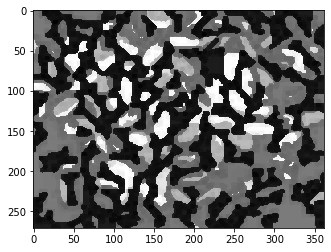

In [72]:
kernel_1 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(6, 6))
eroded_image_gray=cv2.erode(gray_image,kernel_1)
kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(6, 6))
plt.imshow(eroded_image_gray, cmap='gray')
plt.show()

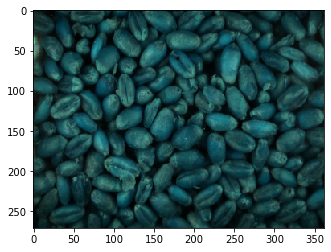

In [73]:
origin_img=cv2.imread('image/wheat.png')
new_width = int(origin_img.shape[1]/4)
new_height = int(origin_img.shape[0]/4)
new_dim = (new_width, new_height)
origin_img = cv2.resize(origin_img, new_dim, interpolation = cv2.INTER_AREA)
origin_img_gray = cv2.cvtColor(origin_img,cv2.COLOR_RGB2GRAY)
plt.imshow(origin_img, cmap='gray')

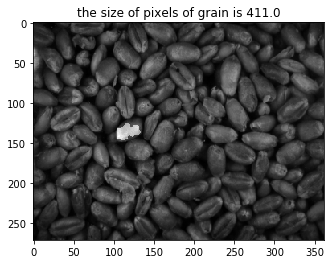

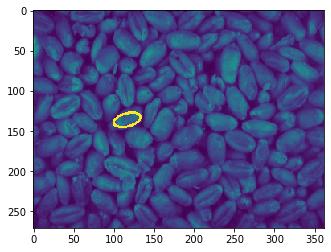

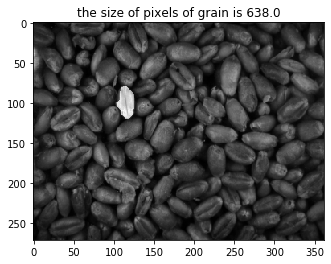

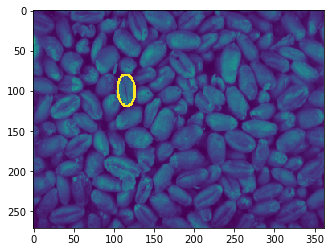

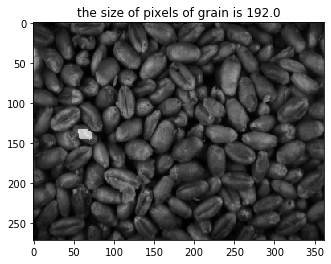

...

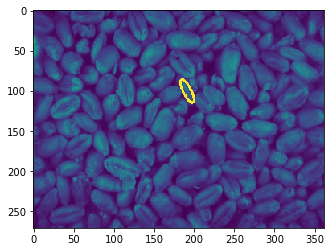

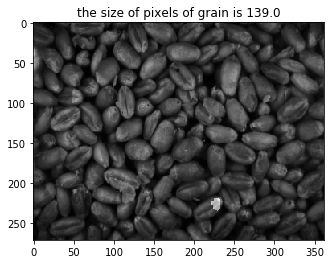

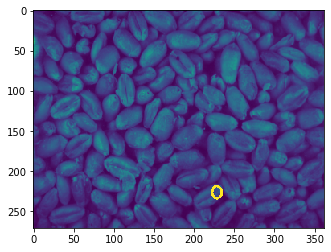

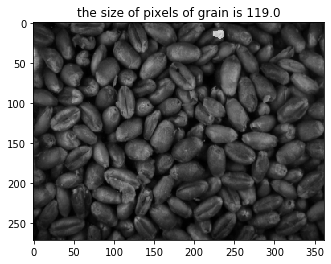

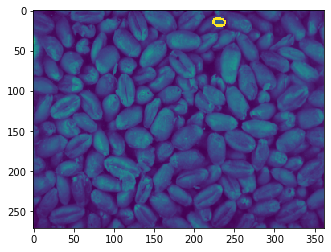

In [74]:
ellipse_x=[]
ellipse_y=[]
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>threshold_2] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=threshold_1,threshold_2=threshold_2, start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    region=np.sum(new_mask)
    if region>100. and region<1200:
        plt.imshow(new_mask*100+origin_img_gray, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        
        temp_new_mask=new_mask.astype('uint8')
        temp_contours, _ = cv2.findContours(temp_new_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        temp_ellipse = cv2.fitEllipse(temp_contours[0])
        temp_image=origin_img_gray.copy()
        cv2.ellipse(temp_image, temp_ellipse, (255, 255, 0), 2)
        plt.imshow(temp_image)
        plt.show()
        ellipse_x.append(temp_ellipse[1][0])
        ellipse_y.append(temp_ellipse[1][1])
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

In [5]:
# define a funcion that return 8 neighbors of a start point that satisfied the set threshold
def find_neighbor(image, start_x, start_y,  threshold_1=50,threshold_2=20):
    img_len = image.shape[0]
    img_width = image.shape[1]
    #new_image=np.zeros((img_len,img_width))
    new_x=np.arange(start_x-1,start_x + 2)
    new_y=np.arange(start_y-1,start_y + 2)
    candidate=[]
    for temp_x in new_x:
        for temp_y in new_y:
            # discard neighbor points that are beyond the size of image
            if temp_x<0 or temp_x>=img_len:
                continue
            if temp_y<0 or temp_y>=img_width:
                continue
            # only get new neighbor points that don't exist in our candidate list
            if [temp_x, temp_y] in candidate:
                continue
            # no need to consider the center point itself
            if temp_x==start_x and temp_y==start_y:
                continue
            #print(image[start_x][start_y],image[temp_x][temp_y],np.abs(image[temp_x][temp_y]-image[start_x][start_y]))
            if image[temp_x][temp_y] > threshold_1:# and np.abs(int(image[temp_x][temp_y])-int(image[start_x][start_y]))<threshold_2:
                candidate.append([temp_x,temp_y])
    return candidate

In [6]:
def region_growing(image,start_x,start_y,threshold_1=50,threshold_2=20):
    # initialization
    img_len = image.shape[0]
    img_width = image.shape[1]
    new_image=np.zeros((img_len,img_width))
    candidates=[[start_x,start_y]]
    
    while len(candidates)>0:
        temp_point = candidates.pop()
        candidate_neigbor=find_neighbor(image, temp_point[0], temp_point[1],threshold_1=threshold_1,threshold_2=threshold_2)
        for temp_neibor in candidate_neigbor:
            if new_image[temp_neibor[0]][temp_neibor[1]]==0:
                # if the candidate neignbor is not in current list, we append the point
                # and set the corresponding pixel in image to 1
                new_image[temp_neibor[0]][temp_neibor[1]]=1
                candidates.append(temp_neibor)
    return new_image,candidates

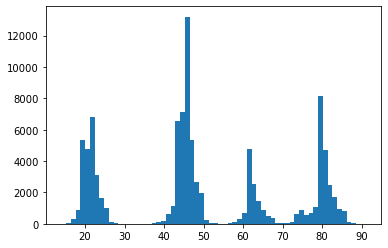

In [7]:
plt.hist(img_gray.ravel(),bins=64)
plt.show()

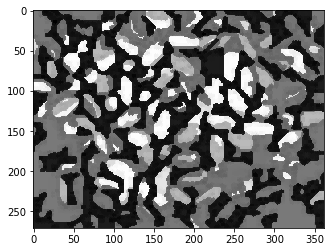

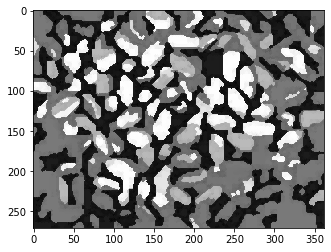

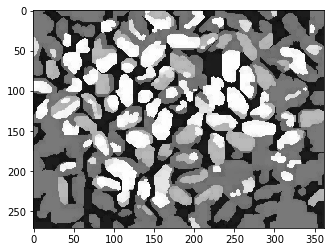

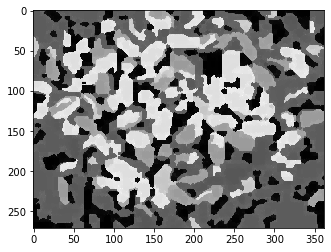

In [8]:
kernel_1 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
eroded_image_gray=cv2.erode(gray_image,kernel_1)
kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3, 3))
new_image_gray=cv2.dilate(eroded_image_gray,kernel_2)
plt.imshow(eroded_image_gray, cmap='gray')
plt.show()
plt.imshow(new_image_gray, cmap='gray')
plt.show()
open_gray= cv2.morphologyEx(gray_image,cv2.MORPH_OPEN,kernel_1)
plt.imshow(open_gray, cmap='gray')
plt.show()
close_gray= cv2.morphologyEx(gray_image,cv2.MORPH_CLOSE,kernel_1)
plt.imshow(close_gray, cmap='gray')
plt.show()

In [9]:
gray_image=skimage.color.rgb2gray(image)*256
temp_threshold=skimage.filters.threshold_minimum(gray_image)
temp_threshold

32.1783137254902

In [10]:
temp_threshold=55

In [ ]:
def separate_polygons(temp_mask,kernel=(5,5)):
    temp_eroeded_mask=cv2.erode(temp_mask,kernel)
    

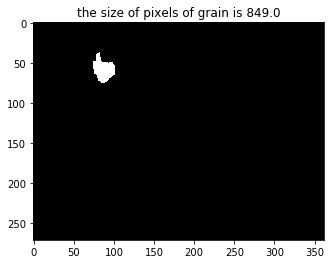

In [92]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    new_mask=cv2.dilate(mask,kernel_1)
    region=np.sum(new_mask)
    if region>100. and region<1500:
        plt.imshow(mask, cmap='gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if region>200:
        break

In [73]:
new_mask=new_mask.reshape(new_mask.shape[0],new_mask.shape[1],1)

In [78]:
new_mask.shape

(271, 362)

In [94]:
new_mask.dtype

dtype('uint8')

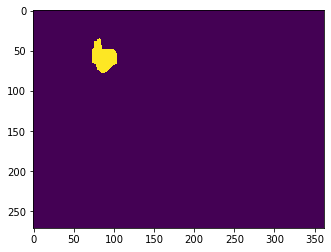

In [95]:
new_mask=new_mask.astype('uint8')
plt.imshow(new_mask)

In [97]:
contours, hierarchy = cv2.findContours(new_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

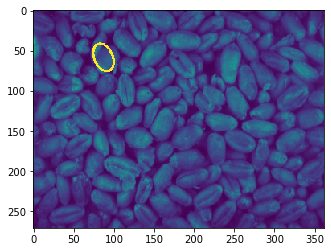

In [120]:
temp_ellipse = cv2.fitEllipse(contours[0])
temp_image=origin_img_gray.copy()
cv2.ellipse(temp_image, temp_ellipse, (255, 255, 0), 2)
plt.imshow(temp_image)

In [102]:
temp_ellipse

((87.14977264404297, 58.40813064575195),
 (22.86165428161621, 35.80160140991211),
 156.24285888671875)

In [100]:
len(contours)

1

In [64]:
#gray = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
#temp_mask=new_mask*255
thresh=cv2.cvtColor(temp_mask, cv2.COLOR_GRAY2BGR)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
img = cv2.drawContours(mask, contours, -1, (0, 255, 0), 3)

error: OpenCV(4.3.0) c:\projects\opencv-python\opencv\modules\imgproc\src\color.simd_helpers.hpp:94: error: (-2:Unspecified error) in function '__cdecl cv::impl::`anonymous-namespace'::CvtHelper<struct cv::impl::`anonymous namespace'::Set<1,-1,-1>,struct cv::impl::A0xe227985e::Set<3,4,-1>,struct cv::impl::A0xe227985e::Set<0,2,5>,2>::CvtHelper(const class cv::_InputArray &,const class cv::_OutputArray &,int)'
> Unsupported depth of input image:
>     'VDepth::contains(depth)'
> where
>     'depth' is 6 (CV_64F)


In [60]:
np.sum(temp_mask)

149685.0

In [18]:
hull = cv2.convexHull(new_mask)

error: OpenCV(4.3.0) C:\projects\opencv-python\opencv\modules\imgproc\src\convhull.cpp:143: error: (-215:Assertion failed) total >= 0 && (depth == CV_32F || depth == CV_32S) in function 'cv::convexHull'


In [51]:
new_mask.dtype=np.uint32

In [40]:
contours, cnt = cv2.findContours(new_mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
img = cv2.drawContours(new_mask, contours,-1,(0,255,0),5)
#hull = cv2.convexHull(cnt)

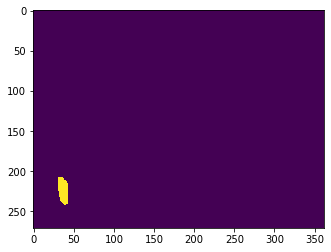

In [34]:
new_mask.dtype=np.uint8
imgray=cv2.cvtColor(new_mask,cv2.COLOR_BGR2GRAY)
ret,thresh=cv2.threshold(imgray,127,255,0)
image,contours,hierarchy=cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)

error: OpenCV(4.3.0) c:\projects\opencv-python\opencv\modules\imgproc\src\color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function '__cdecl cv::impl::`anonymous-namespace'::CvtHelper<struct cv::impl::`anonymous namespace'::Set<3,4,-1>,struct cv::impl::A0xe227985e::Set<1,-1,-1>,struct cv::impl::A0xe227985e::Set<0,2,5>,2>::CvtHelper(const class cv::_InputArray &,const class cv::_OutputArray &,int)'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 1


21209


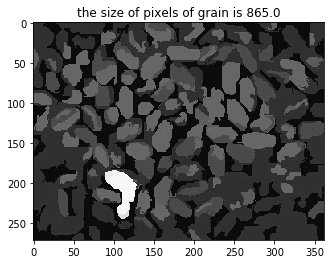

20344


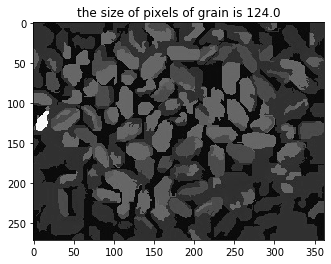

20220


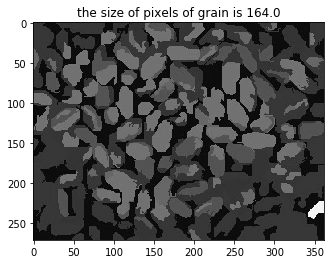

20056


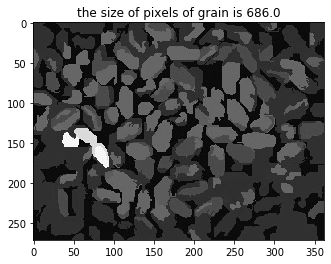

19370


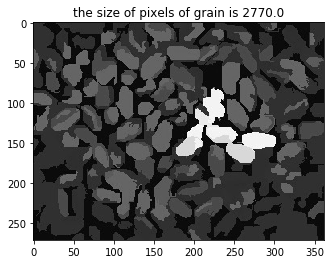

16600


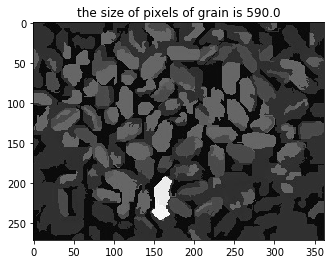

16010


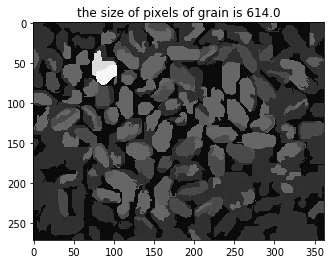

15396


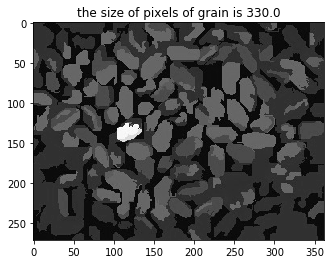

15066


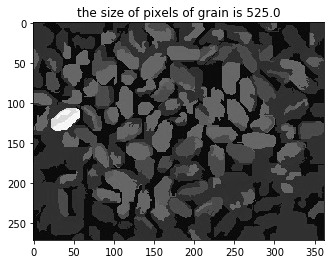

14541


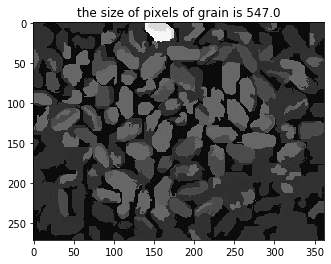

13994


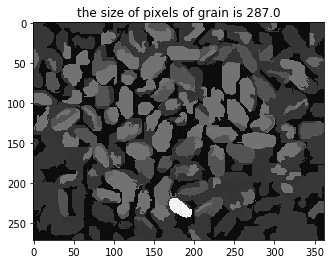

13707


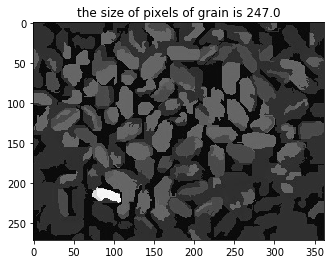

13460


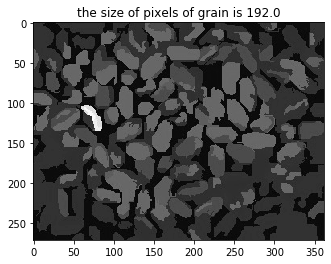

13268
13250


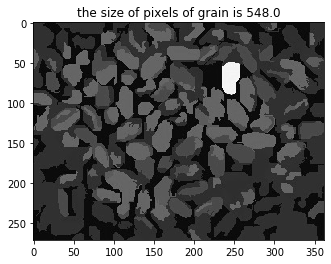

12702


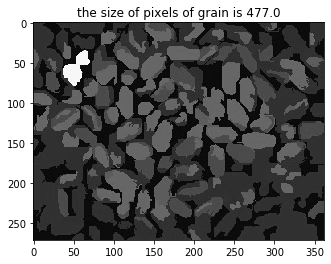

12225


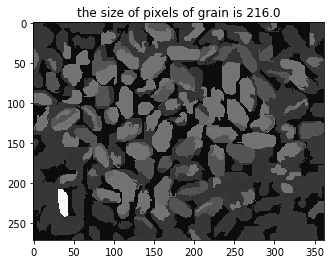

12009


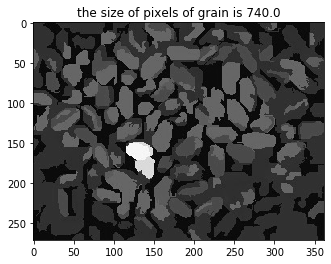

11269


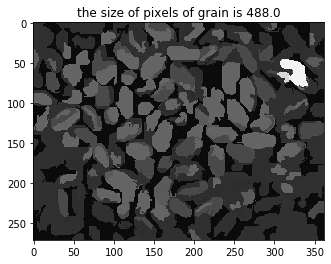

10781


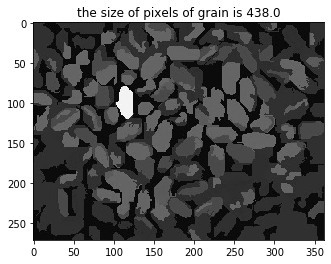

10343


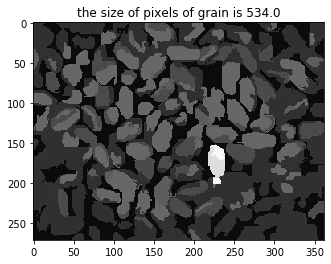

9809


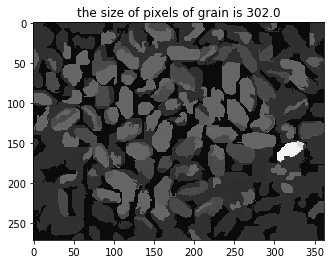

9507


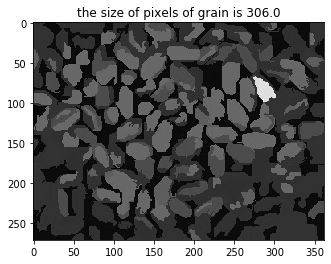

9201


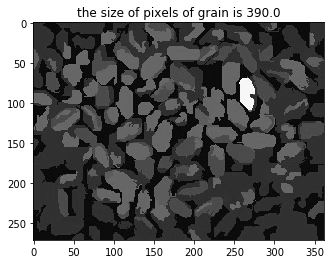

8811


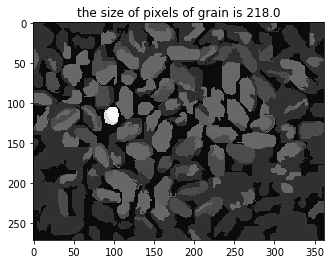

8593


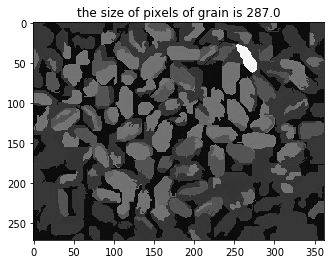

8306


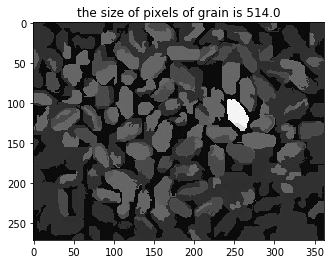

7792


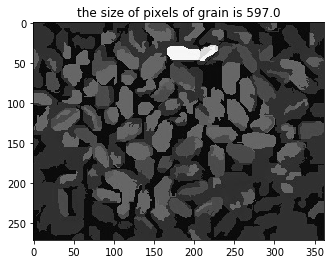

7195


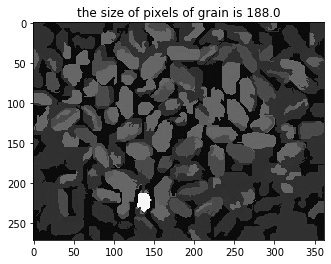

7007


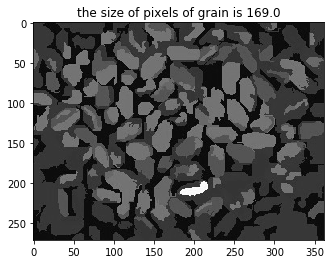

6838


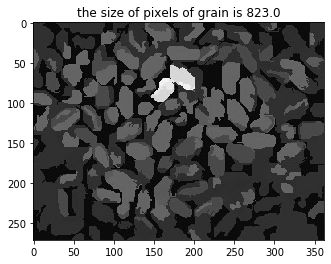

6015


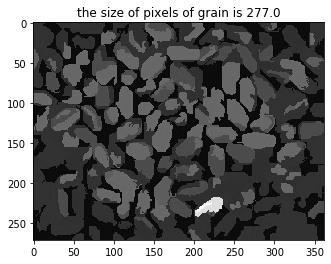

5738


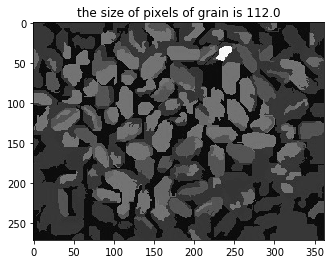

5626


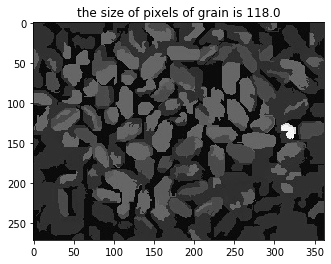

5508


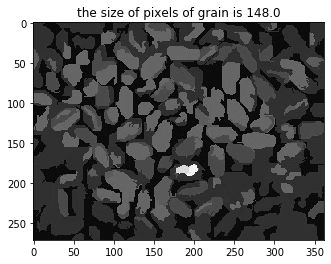

5360


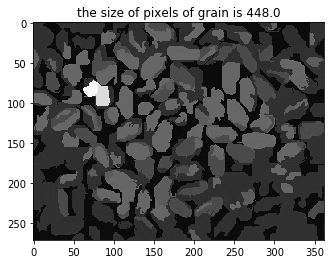

4912


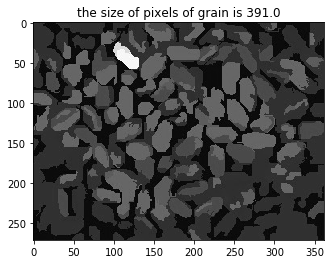

4521


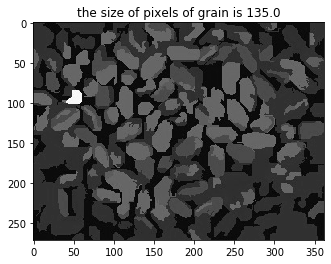

4386


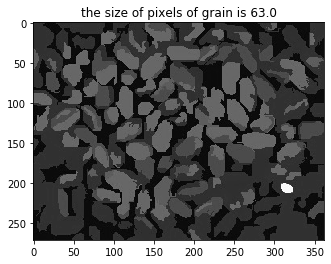

4323


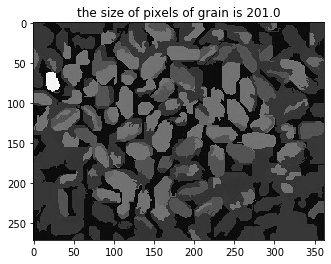

4122


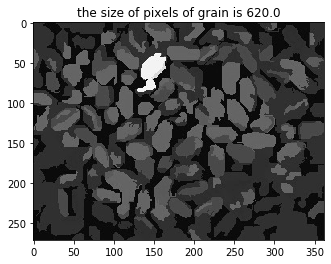

3502


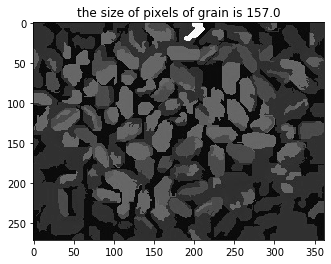

3345


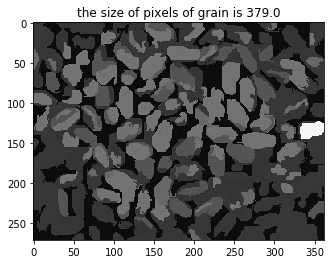

2966


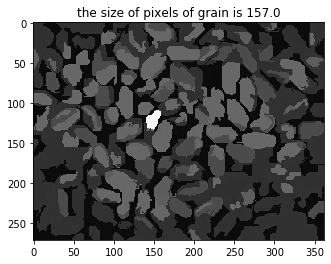

2809


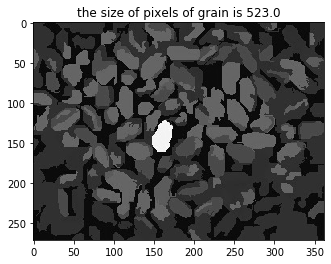

2286


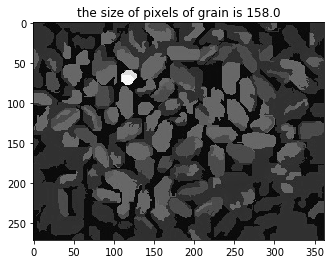

2128


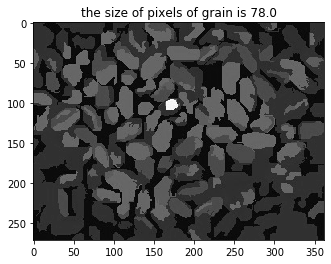

2050


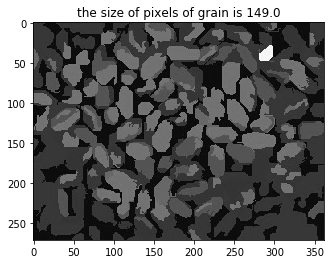

1901


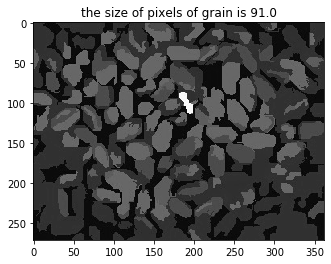

1810


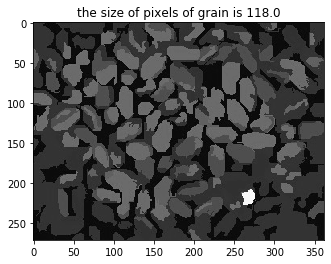

1692
1675


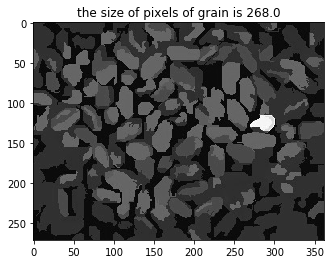

1407
1384
1334
1316


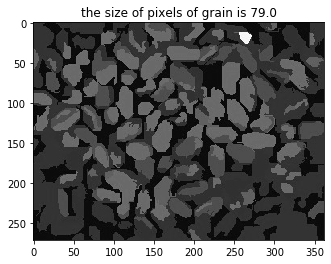

1237


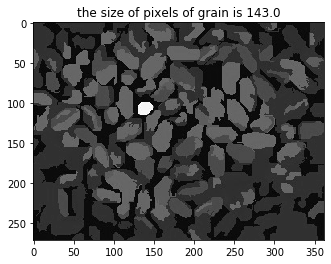

1094


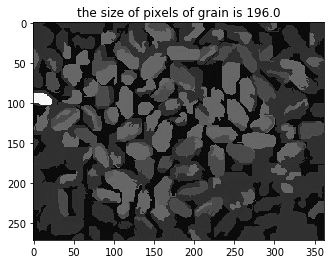

898


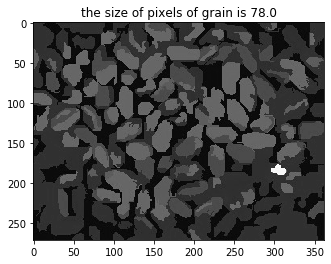

820


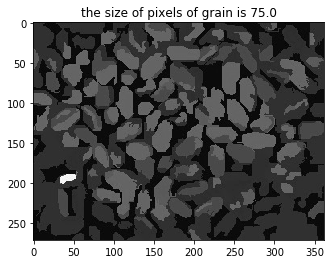

745


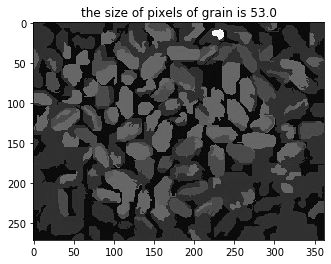

692
669


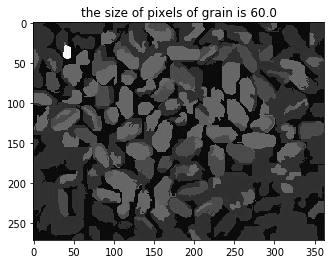

609
560


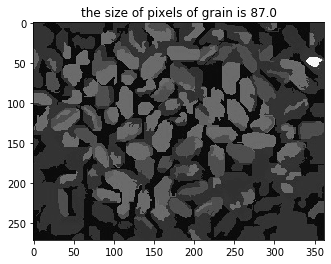

473
438


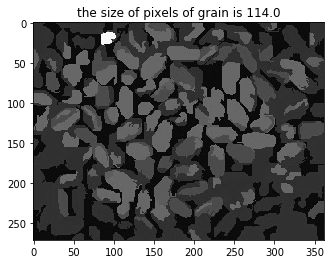

324
291


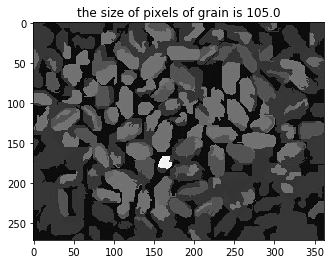

186
160
155


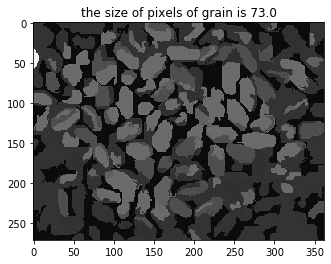

82
73
60


In [34]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>50.:
        plt.imshow(new_mask*100+gray_image, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

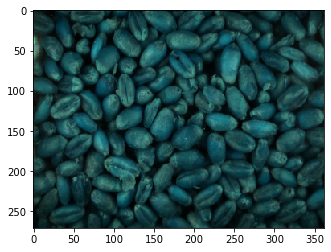

In [123]:
origin_img=cv2.imread('image/wheat.png')
new_width = int(image.shape[1]/1)
new_height = int(image.shape[0]/1)
new_dim = (new_width, new_height)
origin_img = cv2.resize(origin_img, new_dim, interpolation = cv2.INTER_AREA)
plt.imshow(origin_img, cmap='gray')

In [124]:
origin_img_gray = cv2.cvtColor(origin_img,cv2.COLOR_RGB2GRAY)

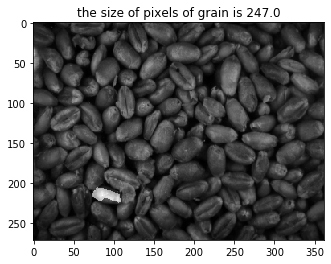

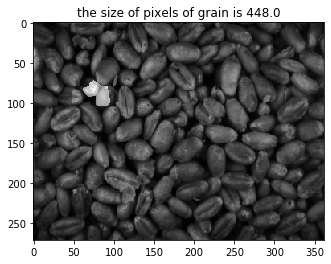

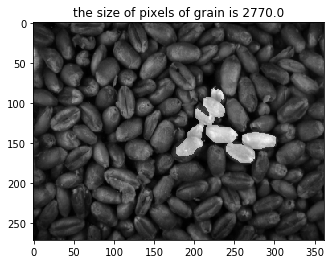

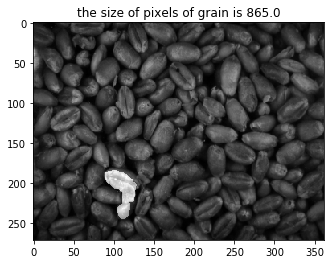

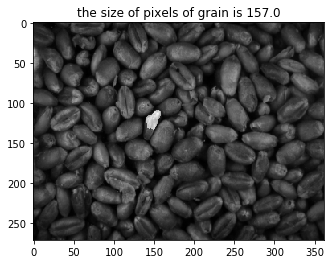

...

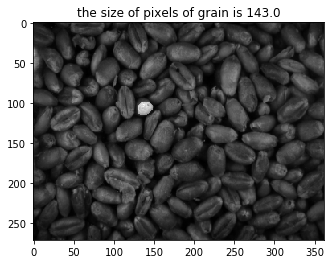

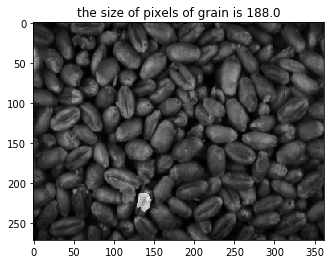

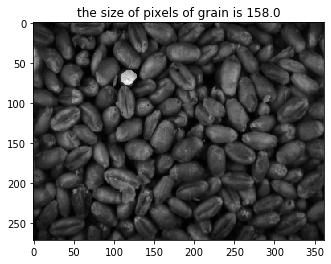

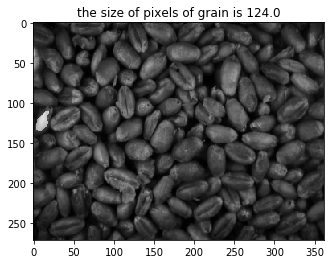

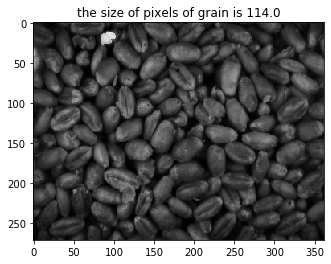

In [41]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>100.:
        plt.imshow(new_mask*100+origin_img_gray, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

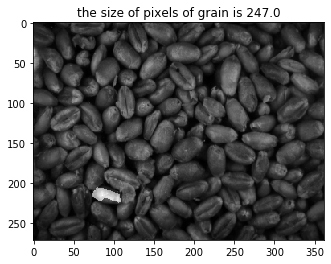

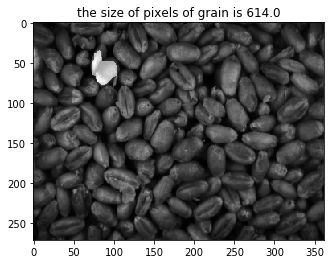

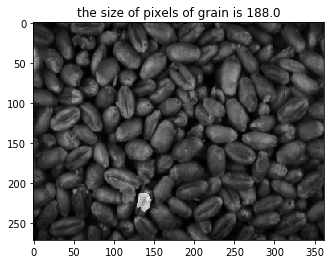

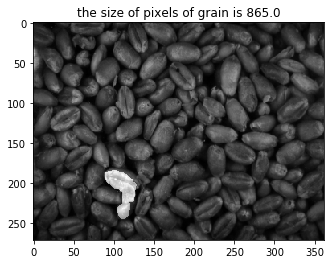

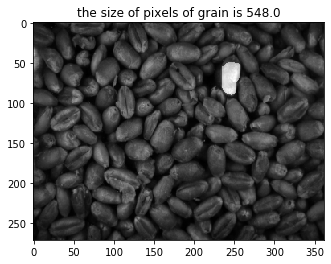

...

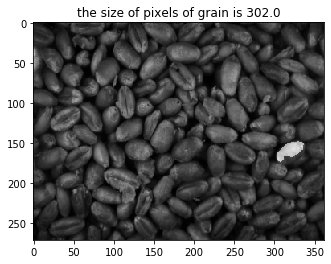

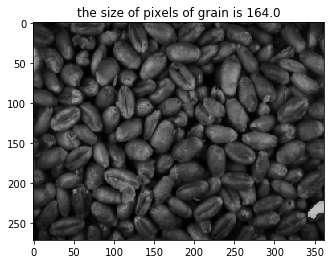

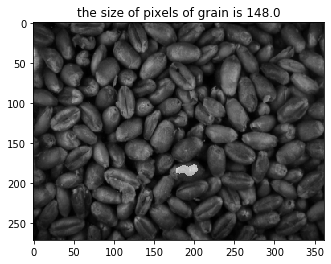

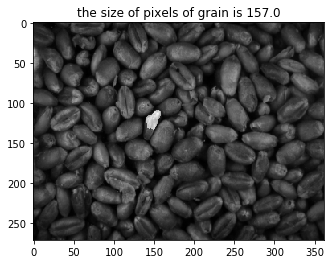

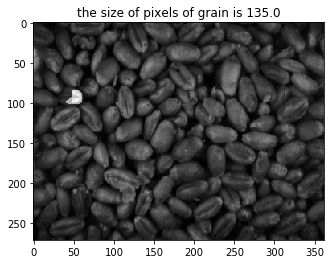

In [79]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>100. and region<1500:
        plt.imshow(new_mask*100+origin_img_gray, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

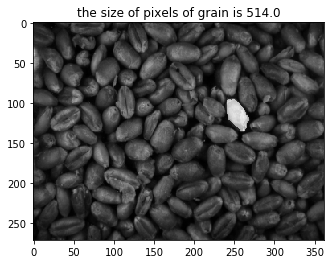

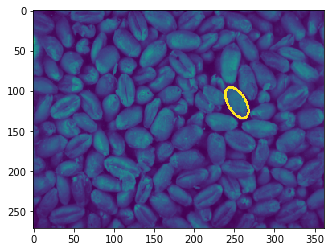

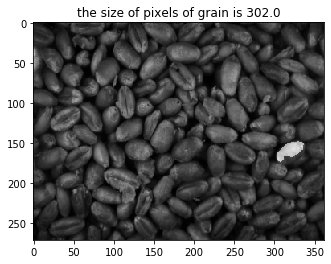

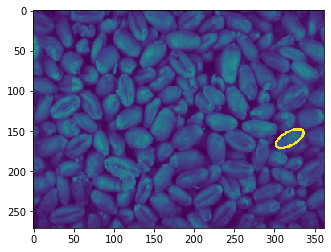

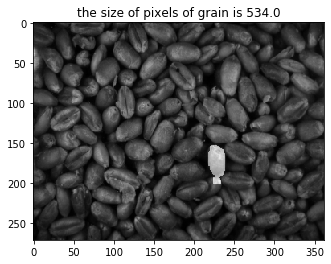

...

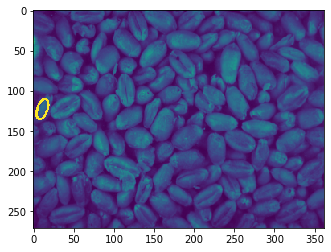

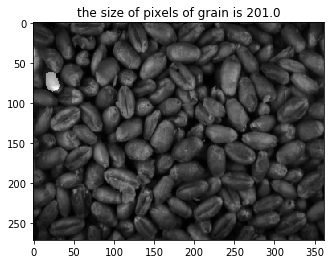

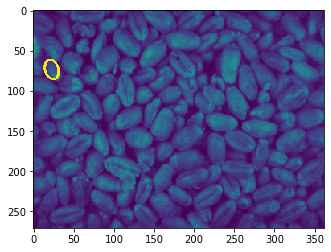

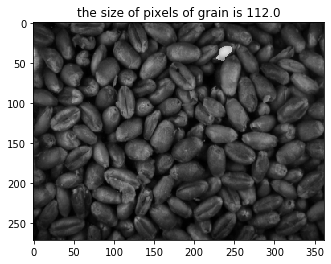

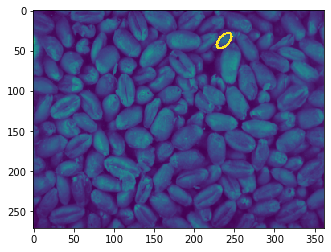

In [128]:
ellipse_x=[]
ellipse_y=[]
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>100. and region<1500:
        plt.imshow(new_mask*100+origin_img_gray, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        
        temp_new_mask=new_mask.astype('uint8')
        temp_contours, _ = cv2.findContours(temp_new_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        temp_ellipse = cv2.fitEllipse(temp_contours[0])
        temp_image=origin_img_gray.copy()
        cv2.ellipse(temp_image, temp_ellipse, (255, 255, 0), 2)
        plt.imshow(temp_image)
        plt.show()
        ellipse_x.append(temp_ellipse[1][0])
        ellipse_y.append(temp_ellipse[1][1])
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

Text(0.5, 1.0, 'Long Axis of Ellipses')

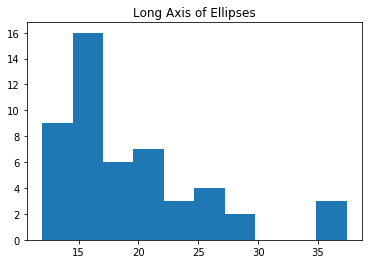

In [133]:
_,_,_=plt.hist(x=ellipse_x)
plt.title('Long Axis of Ellipses')

Text(0.5, 1.0, 'Short Axis of Ellipses')

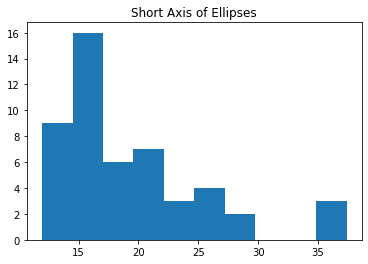

In [134]:
_,_,_=plt.hist(x=ellipse_x)
plt.title('Short Axis of Ellipses')

Text(0.5, 1.0, 'Areas of Fit Ellipses')

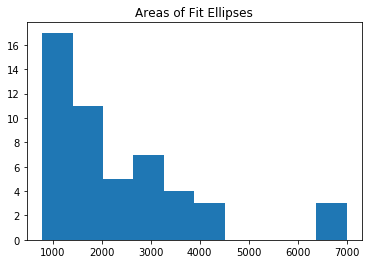

In [138]:
ellipse_area=np.array(ellipse_x)*np.array(ellipse_y)*np.pi
_,_,_=plt.hist(x=ellipse_area)
plt.title('Areas of Fit Ellipses')

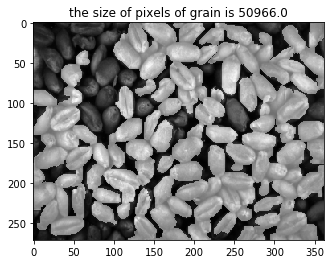

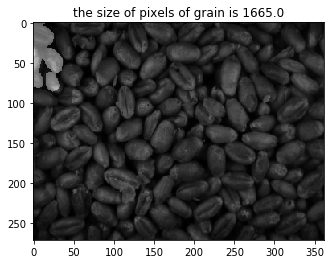

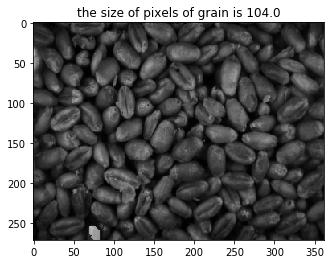

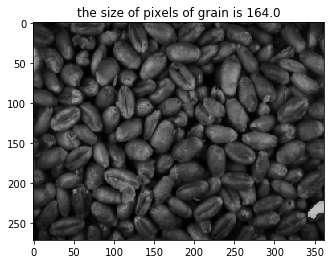

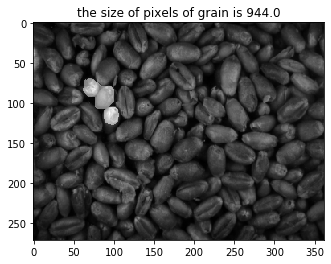

...

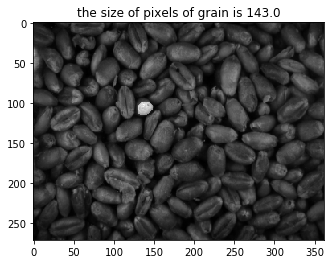

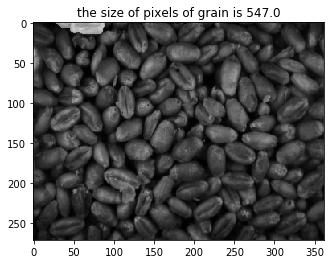

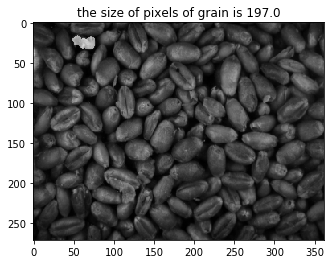

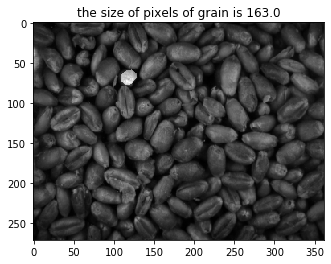

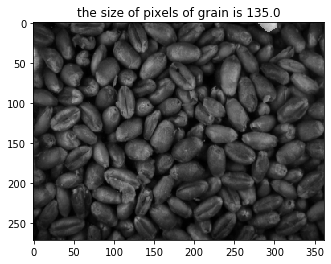

In [93]:
temp_threshold=33
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray.shape[0]) for temp_y in range(eroded_image_gray.shape[1]) 
              if eroded_image_gray[temp_x][temp_y]>temp_threshold] 
i=0
while True:
    temp_len=len(grain_pixels)
    #print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray, threshold_1=temp_threshold,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>100.:
        plt.imshow(new_mask*100+origin_img_gray, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        try:
            ellipse = cv2.fitEllipse(new_mask)
            plt.imshow(ellipse, cmap='gray')
            plt.show()
        except:
            continue
        i+=1
    if i>100 or len(grain_pixels)<50:
        break

In [63]:
np.sum(mask)

13.0

In [67]:
temp_mask=cv2.dilate(mask,kernel_2)
np.sum(temp_mask)

64.0

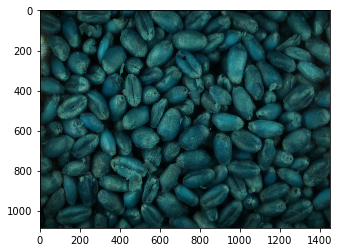

In [42]:
origin_img=cv2.imread('image/bean.png')
plt.imshow(origin_img, cmap='gray')

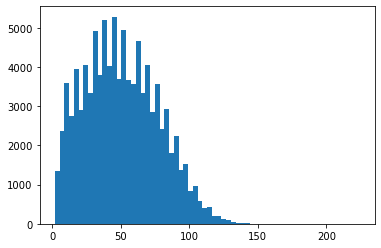

In [44]:
plt.hist(origin_img_gray.ravel(),bins=64)
plt.show()

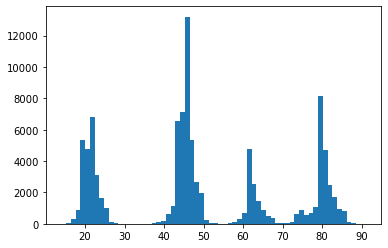

In [45]:
plt.hist(img_gray.ravel(),bins=64)
plt.show()

In [22]:
origin_img_gray = cv2.cvtColor(origin_img,cv2.COLOR_RGB2GRAY)
mask = region_growing(origin_img_gray, threshold_2=55,start_x=818,start_y=272)
region=np.sum(mask)
plt.imshow(mask, cmap='gray')
plt.title('the size of pixels of grain is '+str(region))

ValueError: operands could not be broadcast together with shapes (1086,1448) (0,) 

In [152]:
new_image= ndimage.grey_erosion(gray_image,size = (3,3))
# discard the noisse
new_image[new_image<50]=0
# Laplacian transformation of images
new_image = cv2.convertScaleAbs(cv.Laplacian(new_image, cv.CV_16S, 3))
plt.imshow(new_image,'gray')
plt.show()

error: OpenCV(4.3.0) C:/projects/opencv-python/opencv/modules/imgproc/src/filter.simd.hpp:3110: error: (-215:Assertion failed) cn == CV_MAT_CN(dstType) && ddepth >= sdepth in function 'cv::opt_AVX2::getLinearFilter'


In [168]:
import matplotlib.pyplot as plt

from skimage import data, color, img_as_ubyte
from skimage.feature import canny
from skimage.transform import hough_ellipse
from skimage.draw import ellipse_perimeter

# Load picture, convert to grayscale and detect edges
#image_rgb = data.coffee()[0:220, 160:420]
#image_gray = color.rgb2gray(image_rgb)
edges = canny(gray_image, sigma=2.0,
              low_threshold=0.55, high_threshold=0.8)

# Perform a Hough Transform
# The accuracy corresponds to the bin size of a major axis.
# The value is chosen in order to get a single high accumulator.
# The threshold eliminates low accumulators
result = hough_ellipse(edges, accuracy=20, threshold=250,
                       min_size=100, max_size=120)
result.sort(order='accumulator')

# Estimated parameters for the ellipse
best = list(result[-1])
yc, xc, a, b = [int(round(x)) for x in best[1:5]]
orientation = best[5]

# Draw the ellipse on the original image
cy, cx = ellipse_perimeter(yc, xc, a, b, orientation)
image_rgb[cy, cx] = (0, 0, 255)
# Draw the edge (white) and the resulting ellipse (red)
edges = color.gray2rgb(img_as_ubyte(edges))
edges[cy, cx] = (250, 0, 0)

fig2, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(8, 4),
                                sharex=True, sharey=True)

ax1.set_title('Original picture')
ax1.imshow(image_rgb)

ax2.set_title('Edge (white) and result (red)')
ax2.imshow(edges)

plt.show()

KeyboardInterrupt: 

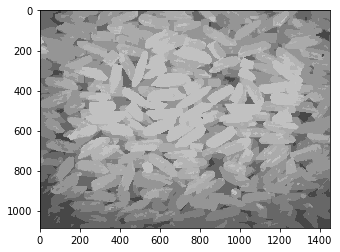

In [23]:
image_2 = cv2.imread('seg_ce_min_8_min_6.jpg')
plt.imshow( image_2,cmap='gray')
img_gray_2 = cv2.cvtColor(image_2,cv2.COLOR_RGB2GRAY)

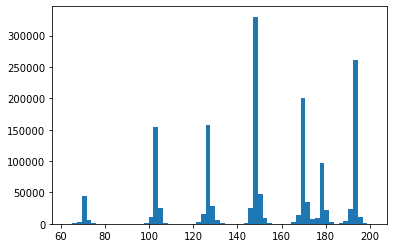

In [24]:
plt.hist(img_gray_2.ravel(),bins=64)
plt.show()

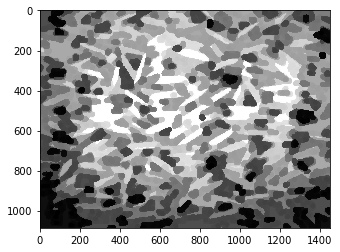

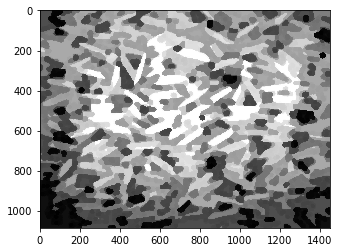

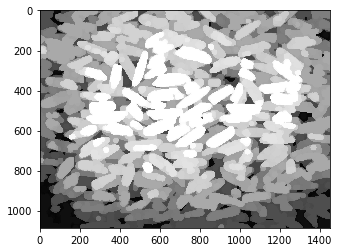

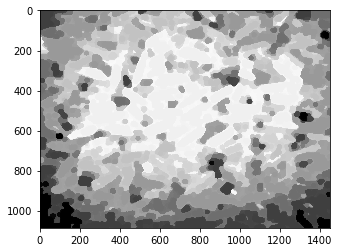

In [40]:
kernel_1 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(25, 25))
eroded_image_gray_2=cv2.erode(img_gray_2,kernel_1)
kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
new_image_gray_2=cv2.dilate(eroded_image_gray_2,kernel_2)
plt.imshow(eroded_image_gray_2, cmap='gray')
plt.show()
plt.imshow(new_image_gray_2, cmap='gray')
plt.show()
open_gray_2= cv2.morphologyEx(img_gray_2,cv2.MORPH_OPEN,kernel_1)
plt.imshow(open_gray_2, cmap='gray')
plt.show()
close_gray_2= cv2.morphologyEx(img_gray_2,cv2.MORPH_CLOSE,kernel_1)
plt.imshow(close_gray_2, cmap='gray')
plt.show()

358769


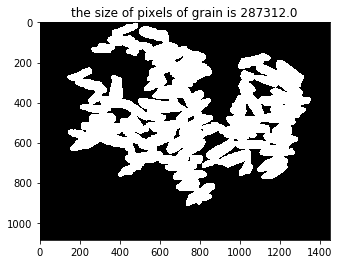

71457


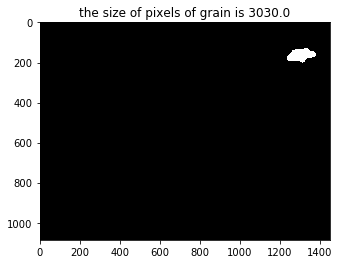

68427


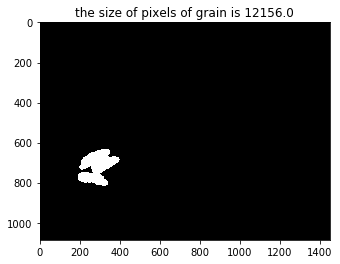

56271
55780


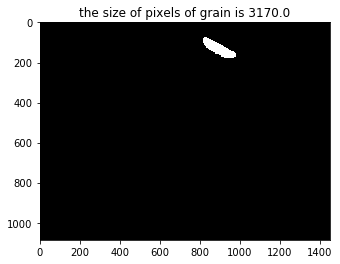

52610


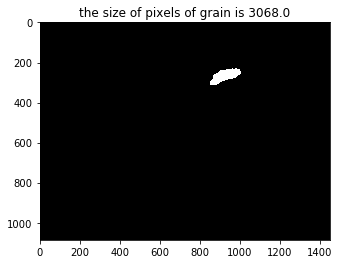

49542


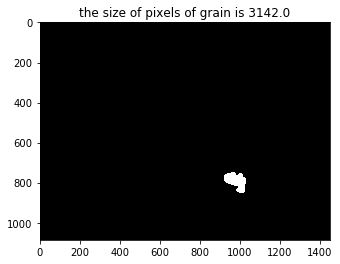

46400


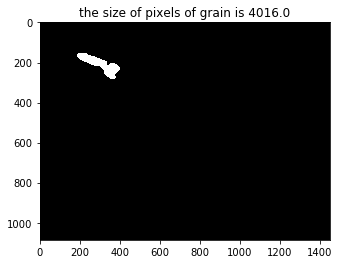

42384


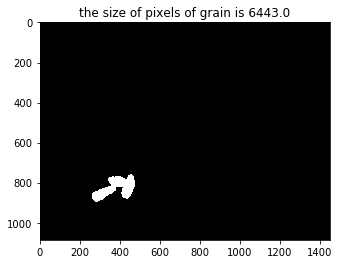

35941


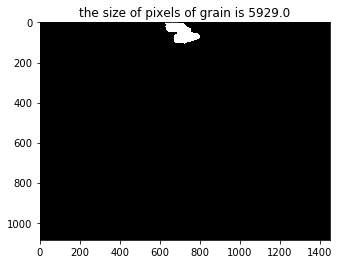

30012


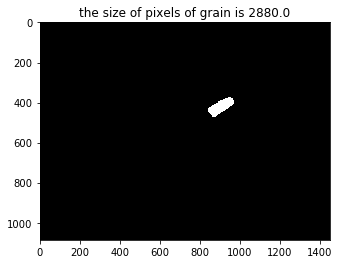

27132


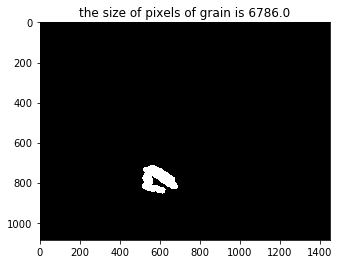

20346


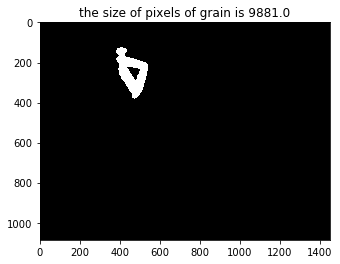

10465
10077


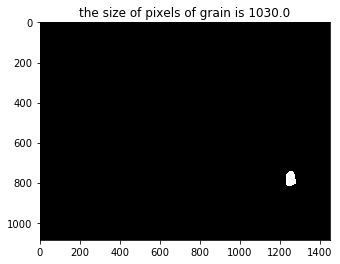

9047
8216


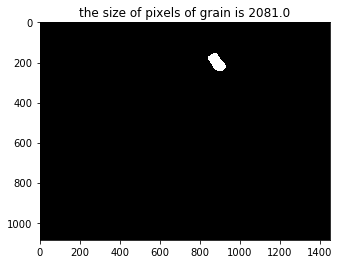

6135


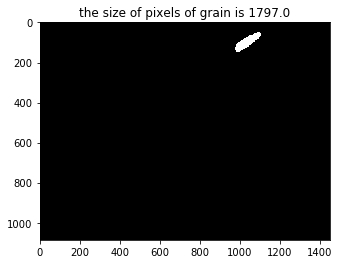

4338


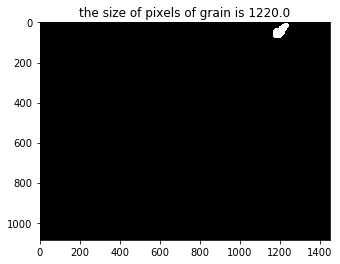

3118


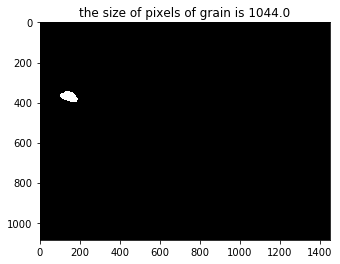

2074
1445
1004


In [41]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray_2.shape[0]) for temp_y in range(eroded_image_gray_2.shape[1]) 
              if eroded_image_gray_2[temp_x][temp_y]>160] 
i=0
while True:
    temp_len=len(grain_pixels)
    print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray_2, threshold_1=160,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>1000.:
        plt.imshow(new_mask*100, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<1000:
        break

486221


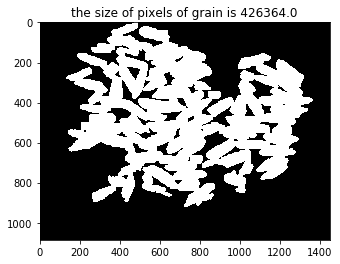

59857


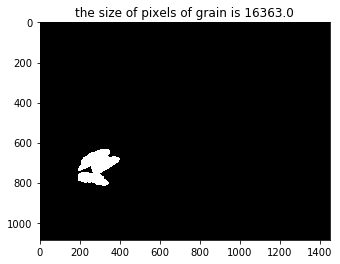

43494


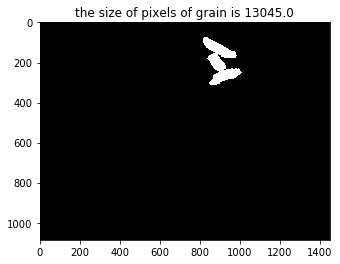

30449


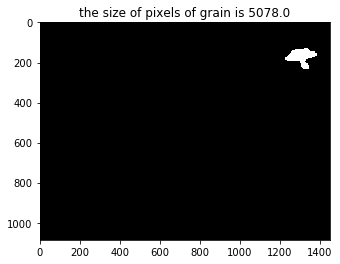

25371
24424
24278


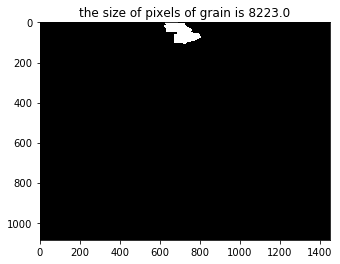

16055


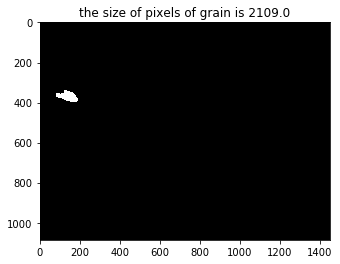

13946
13757


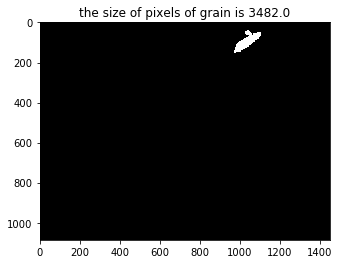

10275


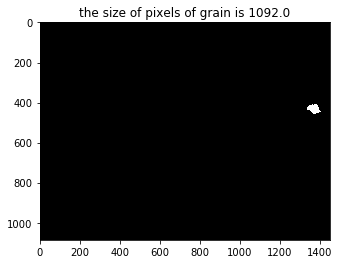

9183
8856
8120


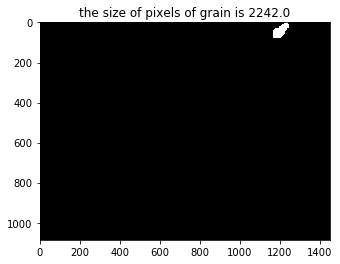

5878


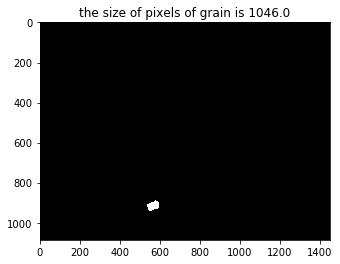

4832


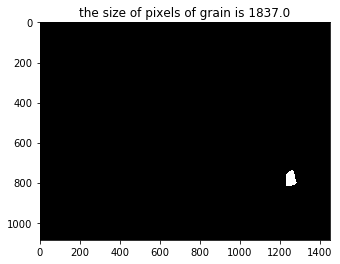

2995


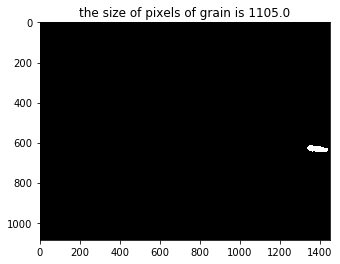

1890


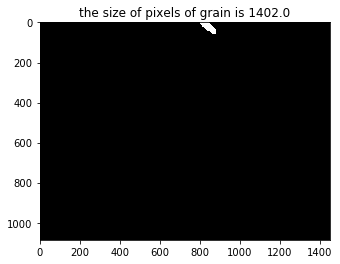

In [37]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray_2.shape[0]) for temp_y in range(eroded_image_gray_2.shape[1]) 
              if eroded_image_gray_2[temp_x][temp_y]>160] 
i=0
while True:
    temp_len=len(grain_pixels)
    print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray_2, threshold_1=160,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>1000.:
        plt.imshow(new_mask*100, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<1000:
        break

In [39]:
grain_pixels=[[temp_x, temp_y] for temp_x in range(eroded_image_gray_2.shape[0]) for temp_y in range(eroded_image_gray_2.shape[1]) 
              if eroded_image_gray_2[temp_x][temp_y]>160] 
i=0
while True:
    temp_len=len(grain_pixels)
    print(temp_len)
    temp_index=np.random.randint(temp_len)
    temp_x,temp_y=grain_pixels[temp_index]
    mask,_ = region_growing(eroded_image_gray_2, threshold_1=184,start_x=temp_x,start_y=temp_y)
    region=np.sum(mask)
    temp_cand=[[temp_x, temp_y] for temp_x in range(mask.shape[0]) for temp_y in range(mask.shape[1]) 
              if mask[temp_x][temp_y]>0] 
    #print(temp_cand)
    for temp_coord in temp_cand:
        grain_pixels.remove(temp_coord)
    kernel_2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5))
    new_mask=cv2.dilate(mask,kernel_1)
    if region>1000.:
        plt.imshow(new_mask*184, cmap='gray')
        #plt.subplot(1, 2, 1).imshow(new_mask*100+gray_image , cmap = 'gray')
        #plt.subplot(1, 2, 2).imshow(gray_image , cmap = 'gray')
        plt.title('the size of pixels of grain is '+str(region))
        plt.show()
        i+=1
    if i>100 or len(grain_pixels)<1000:
        break

486221
486221


KeyboardInterrupt: 